In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/intelligent-manufacturing-dataset/manufacturing_6G_dataset.csv


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score

# Models
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb
import lightgbm as lgb


import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D
from wordcloud import WordCloud
from sklearn.ensemble import RandomForestClassifier


In [3]:
df = pd.read_csv("/kaggle/input/intelligent-manufacturing-dataset/manufacturing_6G_dataset.csv")

In [4]:
df.head()

,Timestamp,Machine_ID,Operation_Mode,Temperature_C,Vibration_Hz,Power_Consumption_kW,Network_Latency_ms,Packet_Loss_%,Quality_Control_Defect_Rate_%,Production_Speed_units_per_hr,Predictive_Maintenance_Score,Error_Rate_%,Efficiency_Status
0,2024-01-01 00:00:00,39,Idle,74.137590,3.500595,8.612162,10.650542,0.207764,7.751261,477.657391,0.344650,14.965470,Low
1,2024-01-01 00:01:00,29,Active,84.264558,3.355928,2.268559,29.111810,2.228464,4.989172,398.174747,0.769848,7.678270,Low
2,2024-01-01 00:02:00,15,Active,44.280102,2.079766,6.144105,18.357292,1.639416,0.456816,108.074959,0.987086,8.198391,Low
3,2024-01-01 00:03:00,43,Active,40.568502,0.298238,4.067825,29.153629,1.161021,4.582974,329.579410,0.983390,2.740847,Medium
4,2024-01-01 00:04:00,8,Idle,75.063817,0.345810,6.225737,34.029191,4.796520,2.287716,159.113525,0.573117,12.100686,Low


In [5]:
df.isnull().sum()

Timestamp                        0
Machine_ID                       0
Operation_Mode                   0
Temperature_C                    0
Vibration_Hz                     0
Power_Consumption_kW             0
Network_Latency_ms               0
Packet_Loss_%                    0
Quality_Control_Defect_Rate_%    0
Production_Speed_units_per_hr    0
Predictive_Maintenance_Score     0
Error_Rate_%                     0
Efficiency_Status                0
dtype: int64

In [6]:
df.duplicated().sum()

0

In [7]:
df.shape

(100000, 13)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 13 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   Timestamp                      100000 non-null  object 
 1   Machine_ID                     100000 non-null  int64  
 2   Operation_Mode                 100000 non-null  object 
 3   Temperature_C                  100000 non-null  float64
 4   Vibration_Hz                   100000 non-null  float64
 5   Power_Consumption_kW           100000 non-null  float64
 6   Network_Latency_ms             100000 non-null  float64
 7   Packet_Loss_%                  100000 non-null  float64
 8   Quality_Control_Defect_Rate_%  100000 non-null  float64
 9   Production_Speed_units_per_hr  100000 non-null  float64
 10  Predictive_Maintenance_Score   100000 non-null  float64
 11  Error_Rate_%                   100000 non-null  float64
 12  Efficiency_Status              

In [9]:
df.describe()

,Machine_ID,Temperature_C,Vibration_Hz,Power_Consumption_kW,Network_Latency_ms,Packet_Loss_%,Quality_Control_Defect_Rate_%,Production_Speed_units_per_hr,Predictive_Maintenance_Score,Error_Rate_%
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,25.499330,60.041458,2.549959,5.745929,25.555620,2.493418,5.008806,275.916324,0.499385,7.504100
std,14.389439,17.323238,1.414127,2.451271,14.120758,1.443273,2.883666,130.096892,0.288814,4.335896
min,1.000000,30.000138,0.100011,1.500183,1.000025,0.000026,0.000449,50.000375,0.000003,0.000112
25%,13.000000,45.031596,1.323214,3.627318,13.355118,1.245026,2.521591,162.873618,0.248166,3.750148
50%,25.000000,60.033597,2.549441,5.755460,25.536079,2.487667,5.003569,276.648922,0.499209,7.504145
75%,38.000000,74.967217,3.776459,7.860267,37.796372,3.741252,7.506127,388.812761,0.748810,11.273189
max,50.000000,89.998979,4.999974,9.999889,49.999917,4.999975,9.999900,499.996768,0.999978,14.999869


In [10]:
df.columns

Index(['Timestamp', 'Machine_ID', 'Operation_Mode', 'Temperature_C',
       'Vibration_Hz', 'Power_Consumption_kW', 'Network_Latency_ms',
       'Packet_Loss_%', 'Quality_Control_Defect_Rate_%',
       'Production_Speed_units_per_hr', 'Predictive_Maintenance_Score',
       'Error_Rate_%', 'Efficiency_Status'],
      dtype='object')

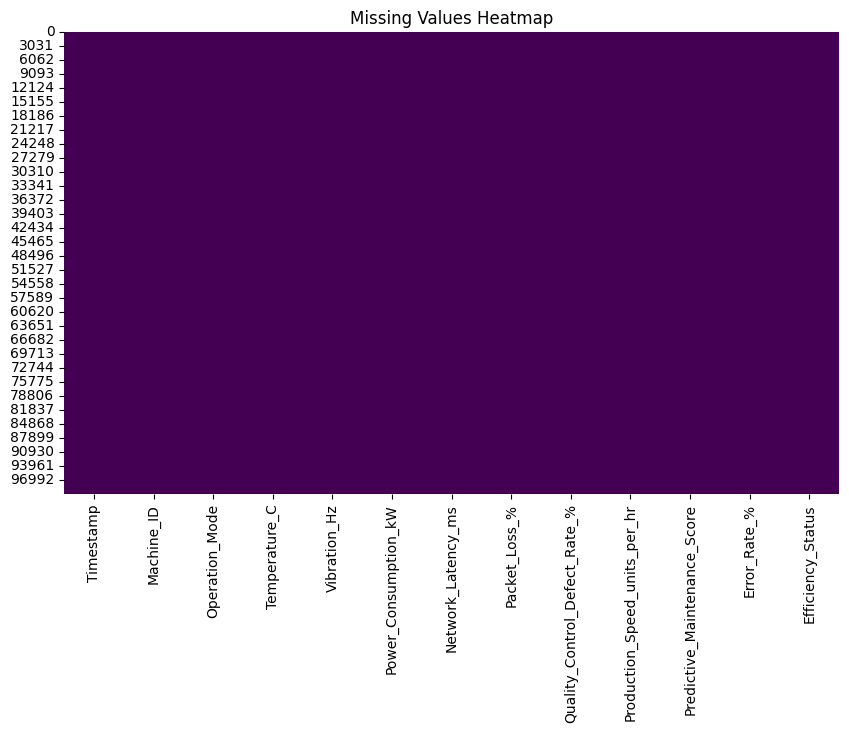

In [11]:
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(), cmap='viridis', cbar=False)
plt.title("Missing Values Heatmap")
plt.show()


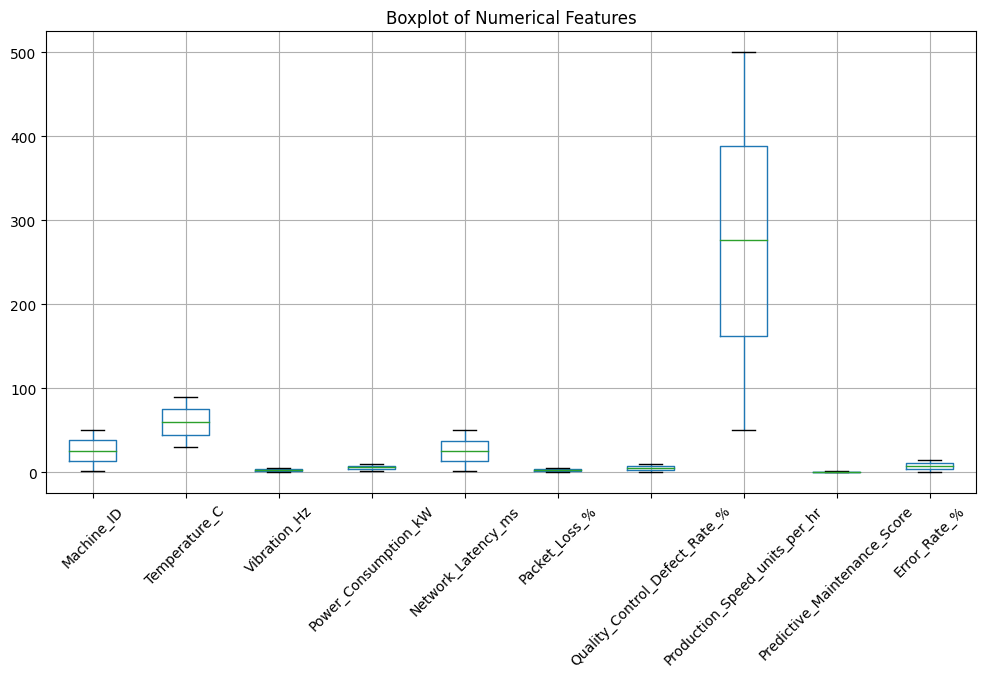

In [12]:
df.boxplot(figsize=(12,6))
plt.xticks(rotation=45)
plt.title("Boxplot of Numerical Features")
plt.show()


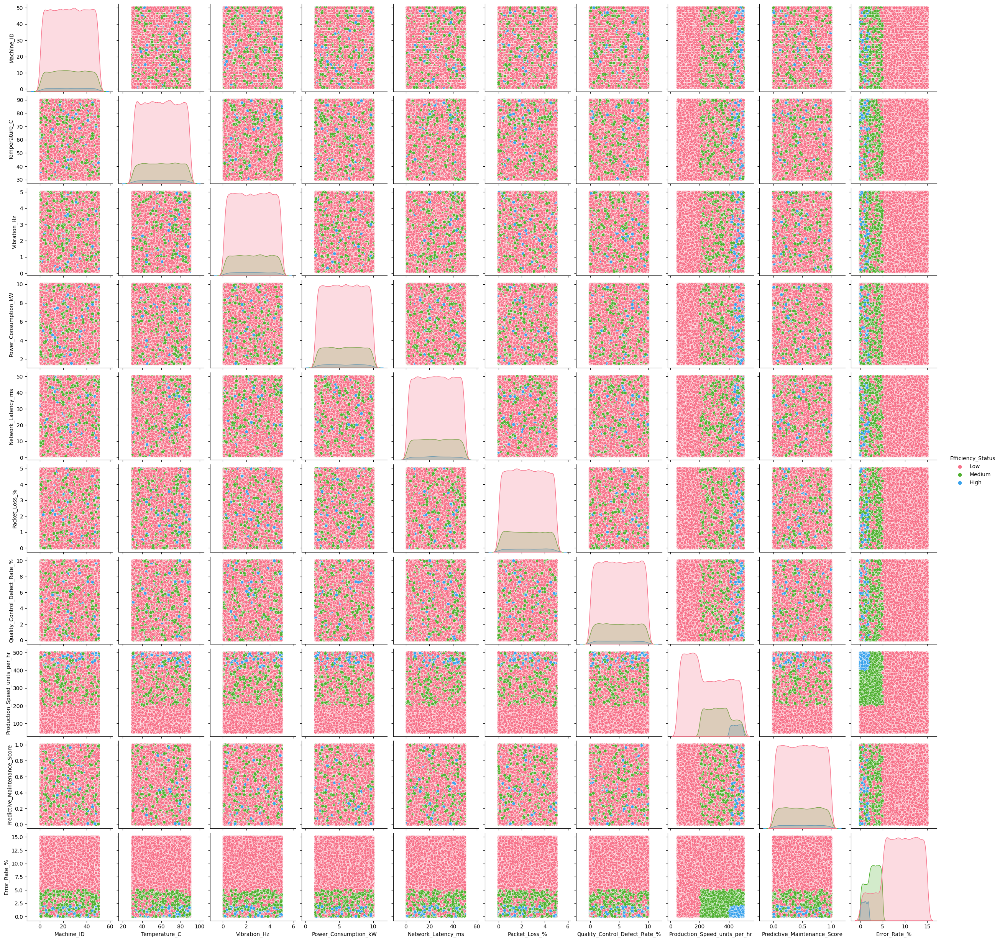

In [13]:
sns.pairplot(df, hue="Efficiency_Status", palette="husl")
plt.show()


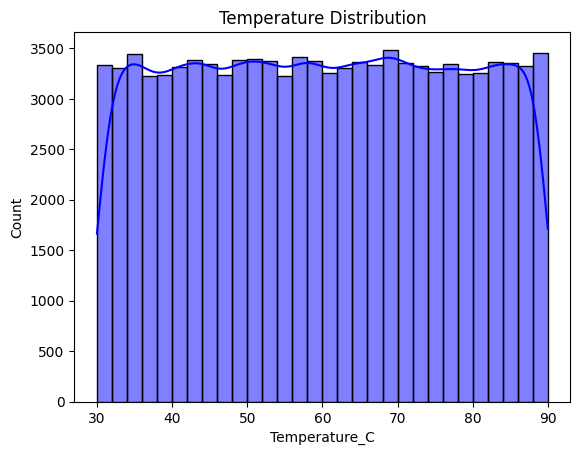

In [14]:
sns.histplot(df["Temperature_C"], bins=30, kde=True, color="blue")
plt.title("Temperature Distribution")
plt.show()


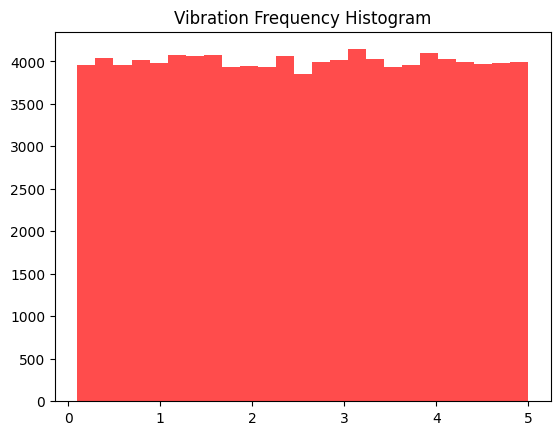

In [15]:
plt.hist(df["Vibration_Hz"], bins=25, color='red', alpha=0.7)
plt.title("Vibration Frequency Histogram")
plt.show()


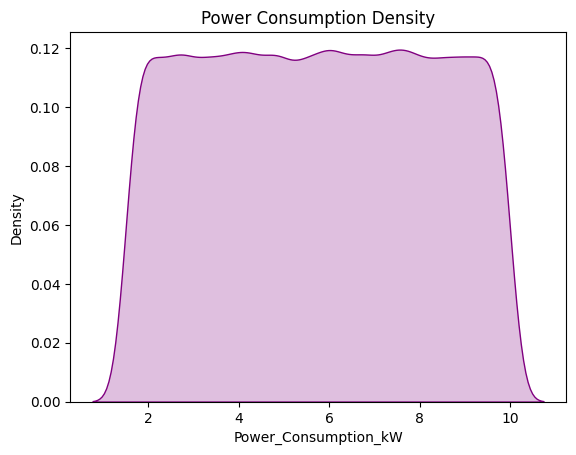

In [16]:
sns.kdeplot(df["Power_Consumption_kW"], shade=True, color="purple")
plt.title("Power Consumption Density")
plt.show()


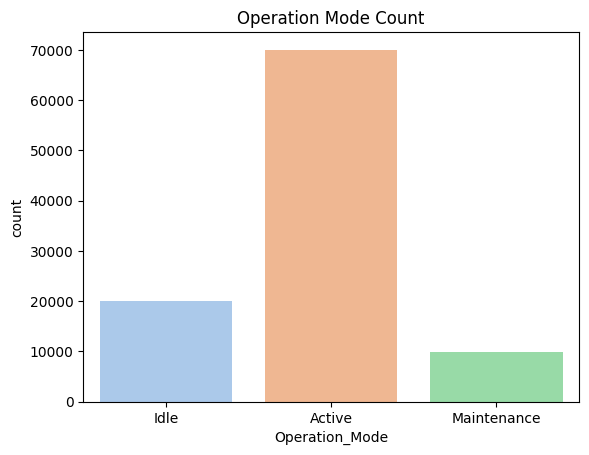

In [17]:
sns.countplot(x=df["Operation_Mode"], palette="pastel")
plt.title("Operation Mode Count")
plt.show()


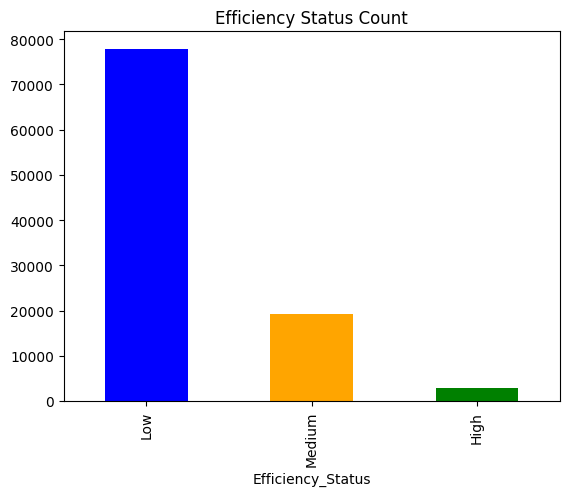

In [18]:
df["Efficiency_Status"].value_counts().plot(kind="bar", color=["blue", "orange", "green"])
plt.title("Efficiency Status Count")
plt.show()


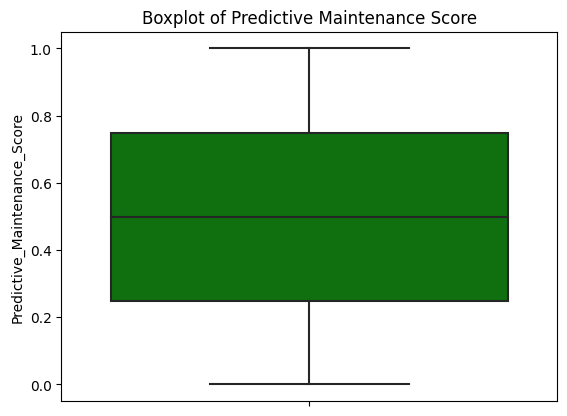

In [19]:
sns.boxplot(y=df["Predictive_Maintenance_Score"], color="green")
plt.title("Boxplot of Predictive Maintenance Score")
plt.show()


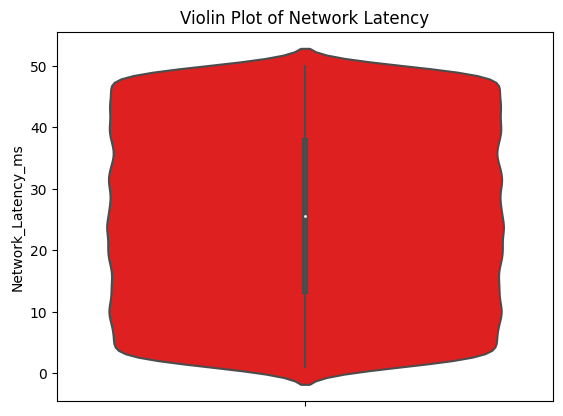

In [20]:
sns.violinplot(y=df["Network_Latency_ms"], color="red")
plt.title("Violin Plot of Network Latency")
plt.show()


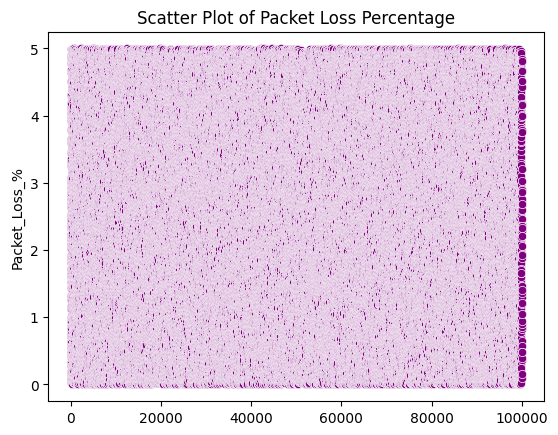

In [21]:
sns.scatterplot(x=df.index, y=df["Packet_Loss_%"], color="purple")
plt.title("Scatter Plot of Packet Loss Percentage")
plt.show()


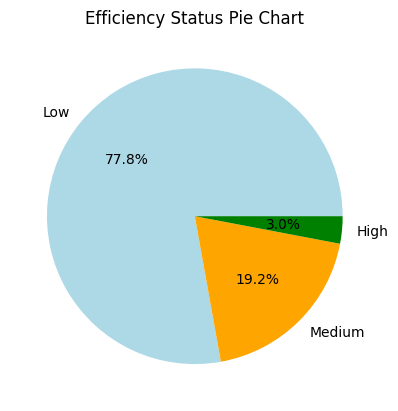

In [22]:
df["Efficiency_Status"].value_counts().plot.pie(autopct="%1.1f%%", colors=["lightblue", "orange", "green"])
plt.title("Efficiency Status Pie Chart")
plt.ylabel("")  
plt.show()


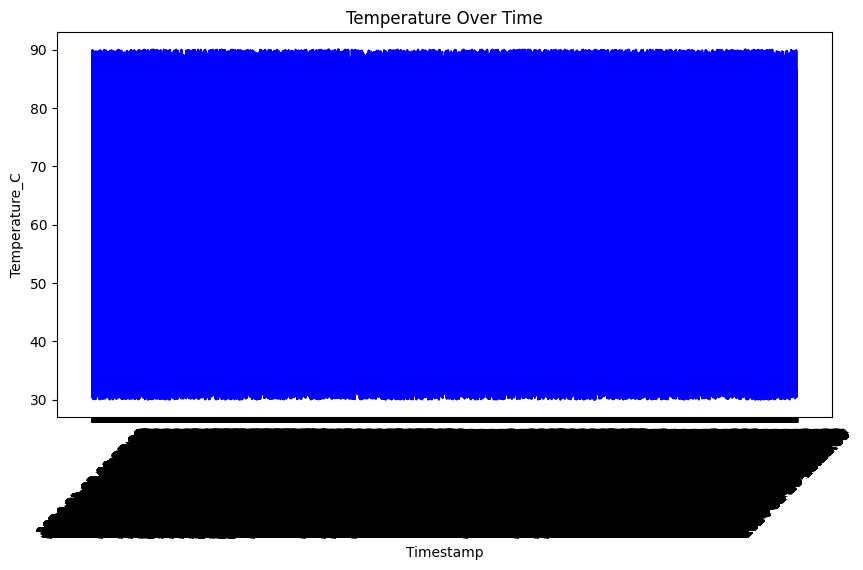

In [23]:
plt.figure(figsize=(10,5))
sns.lineplot(x=df["Timestamp"], y=df["Temperature_C"], color="blue")
plt.xticks(rotation=45)
plt.title("Temperature Over Time")
plt.show()


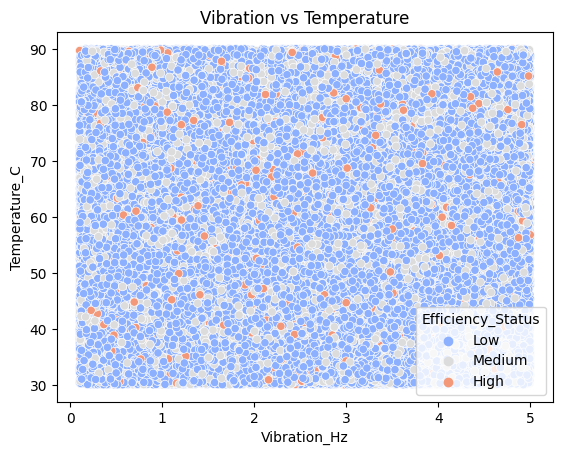

In [24]:
sns.scatterplot(x=df["Vibration_Hz"], y=df["Temperature_C"], hue=df["Efficiency_Status"], palette="coolwarm")
plt.title("Vibration vs Temperature")
plt.show()


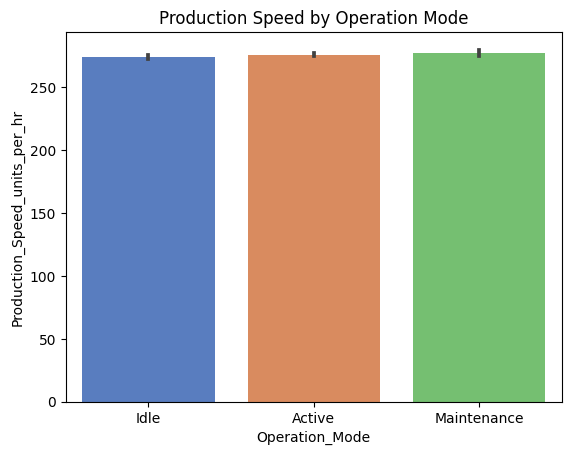

In [25]:
sns.barplot(x="Operation_Mode", y="Production_Speed_units_per_hr", data=df, palette="muted")
plt.title("Production Speed by Operation Mode")
plt.show()


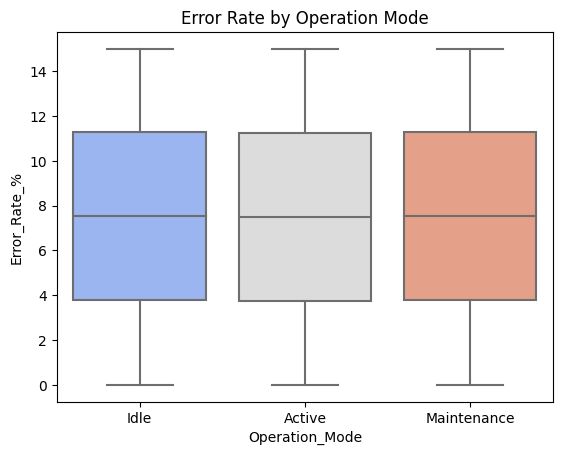

In [26]:
sns.boxplot(x="Operation_Mode", y="Error_Rate_%", data=df, palette="coolwarm")
plt.title("Error Rate by Operation Mode")
plt.show()


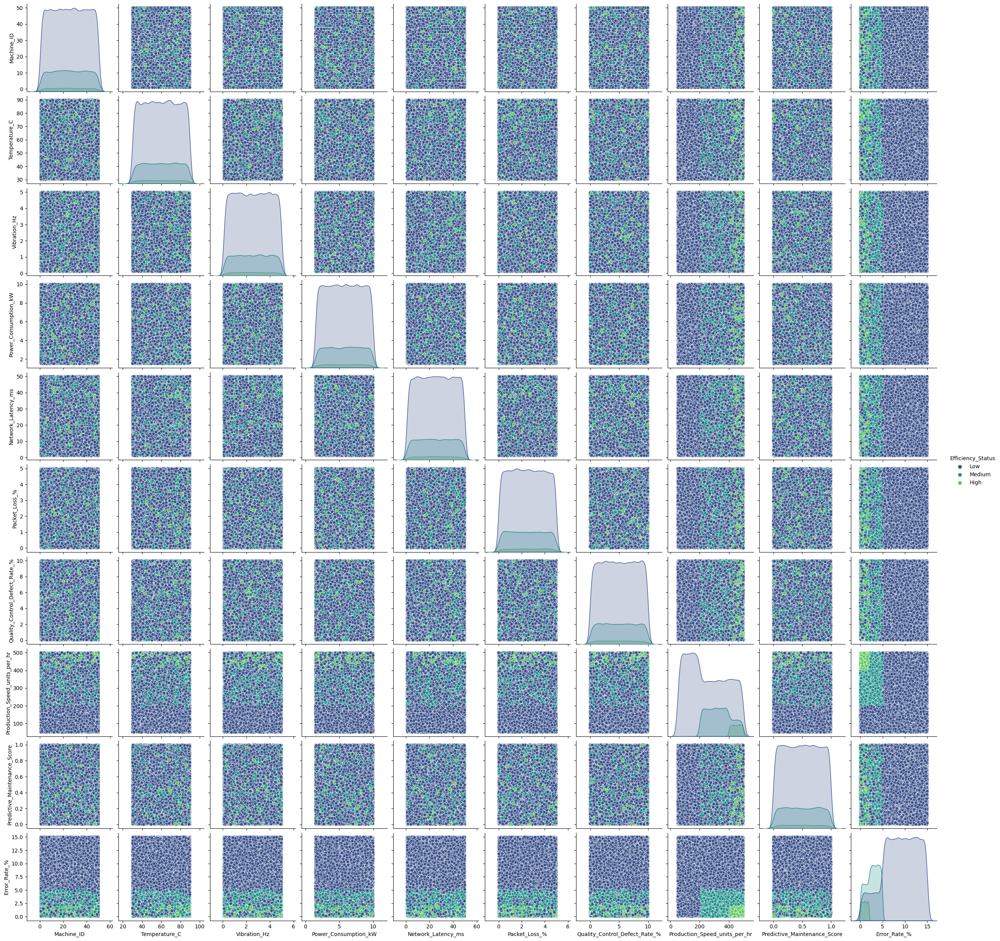

In [27]:
sns.pairplot(df, hue="Efficiency_Status", diag_kind="kde", palette="viridis")
plt.show()


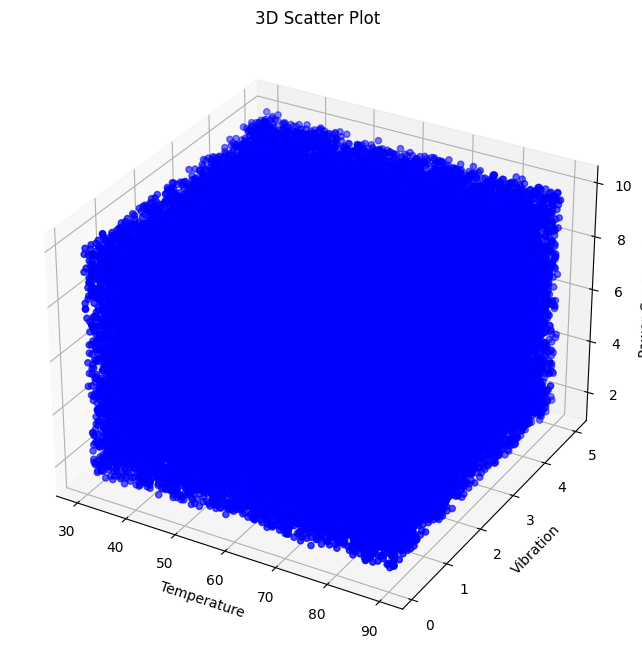

In [28]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection="3d")
ax.scatter(df["Temperature_C"], df["Vibration_Hz"], df["Power_Consumption_kW"], c="blue", marker="o")
ax.set_xlabel("Temperature")
ax.set_ylabel("Vibration")
ax.set_zlabel("Power Consumption")
plt.title("3D Scatter Plot")
plt.show()


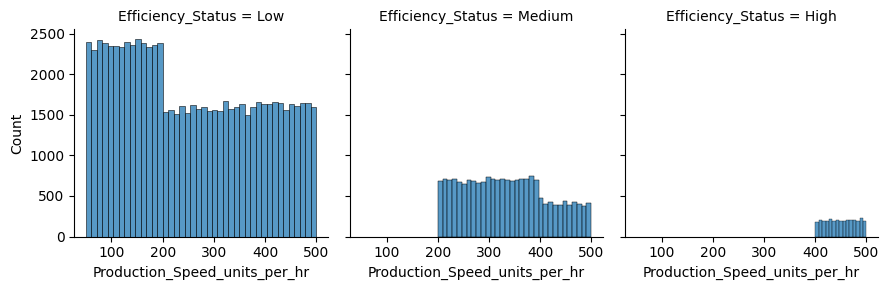

In [29]:
g = sns.FacetGrid(df, col="Efficiency_Status")
g.map(sns.histplot, "Production_Speed_units_per_hr")
plt.show()


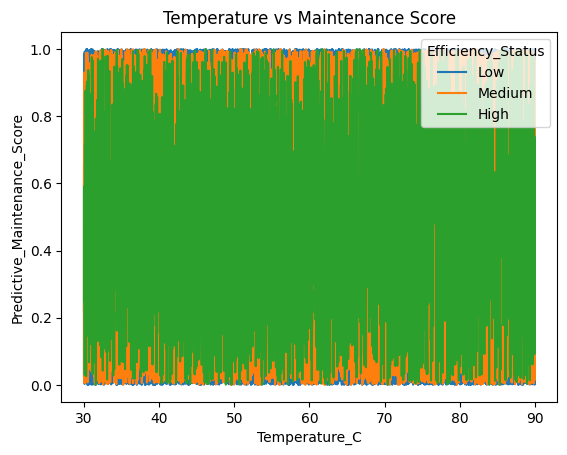

In [30]:
sns.lineplot(x=df["Temperature_C"], y=df["Predictive_Maintenance_Score"], hue=df["Efficiency_Status"])
plt.title("Temperature vs Maintenance Score")
plt.show()


In [31]:
fig = px.sunburst(df, path=["Operation_Mode", "Efficiency_Status"], values="Production_Speed_units_per_hr")
fig.show()


In [32]:
fig = px.treemap(df, path=["Machine_ID", "Efficiency_Status"], values="Power_Consumption_kW")
fig.show()


In [33]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import xgboost as xgb
import lightgbm as lgb
import catboost as cb
import warnings
warnings.filterwarnings("ignore")


In [34]:
le = LabelEncoder()
for col in df.select_dtypes(include=['object']).columns:
    df[col] = le.fit_transform(df[col])


In [35]:
X = df.drop("Efficiency_Status", axis=1)  # Independent Variables
y = df["Efficiency_Status"]                # Target Variable


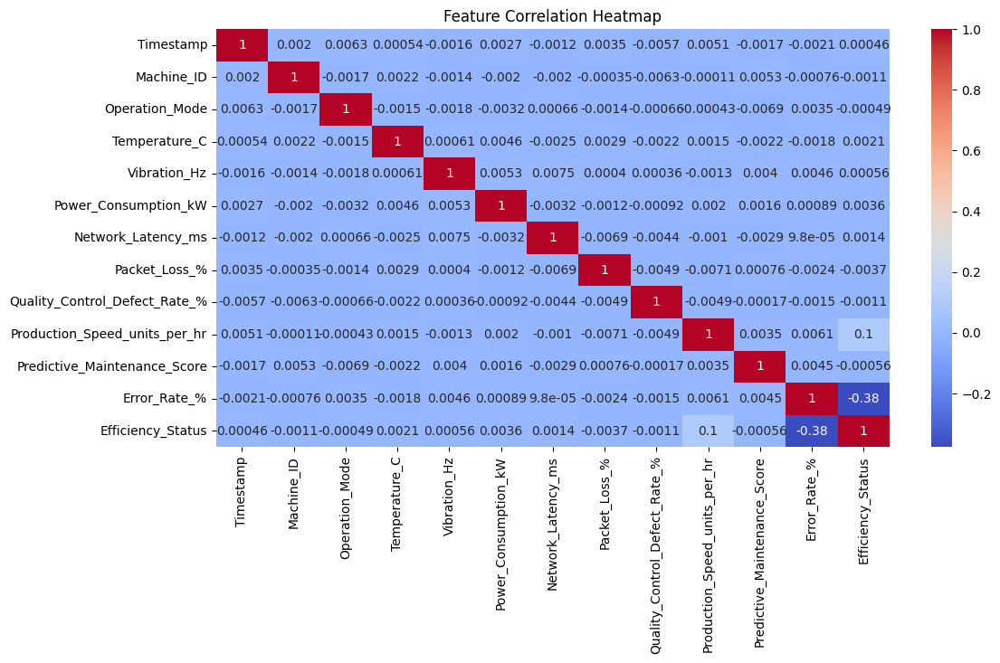

In [36]:
plt.figure(figsize=(12,6))
sns.heatmap(df.corr(), annot=True, cmap="coolwarm")
plt.title("Feature Correlation Heatmap")
plt.show()


In [37]:
from sklearn.feature_selection import SelectFromModel

rf = RandomForestClassifier(n_estimators=100)
rf.fit(X, y)
sfm = SelectFromModel(rf, threshold=0.01)
X_selected = sfm.transform(X)


In [38]:
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)


In [39]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


In [40]:
models = {
    "Logistic Regression": LogisticRegression(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Support Vector Machine": SVC(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Naive Bayes": GaussianNB(),
    "XGBoost": xgb.XGBClassifier(),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0)
}


In [41]:
results = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    results[name] = accuracy
    print(f"{name}: {accuracy:.4f}")
    print(classification_report(y_test, y_pred))


Logistic Regression: 0.9166
              precision    recall  f1-score   support

           0       0.89      0.85      0.87       625
           1       0.95      0.96      0.95     15464
           2       0.80      0.77      0.78      3911

    accuracy                           0.92     20000
   macro avg       0.88      0.86      0.87     20000
weighted avg       0.92      0.92      0.92     20000

K-Nearest Neighbors: 0.9986
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       625
           1       1.00      1.00      1.00     15464
           2       1.00      0.99      1.00      3911

    accuracy                           1.00     20000
   macro avg       1.00      1.00      1.00     20000
weighted avg       1.00      1.00      1.00     20000

Support Vector Machine: 0.9936
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       625
           1       1.00      1.00      1.0

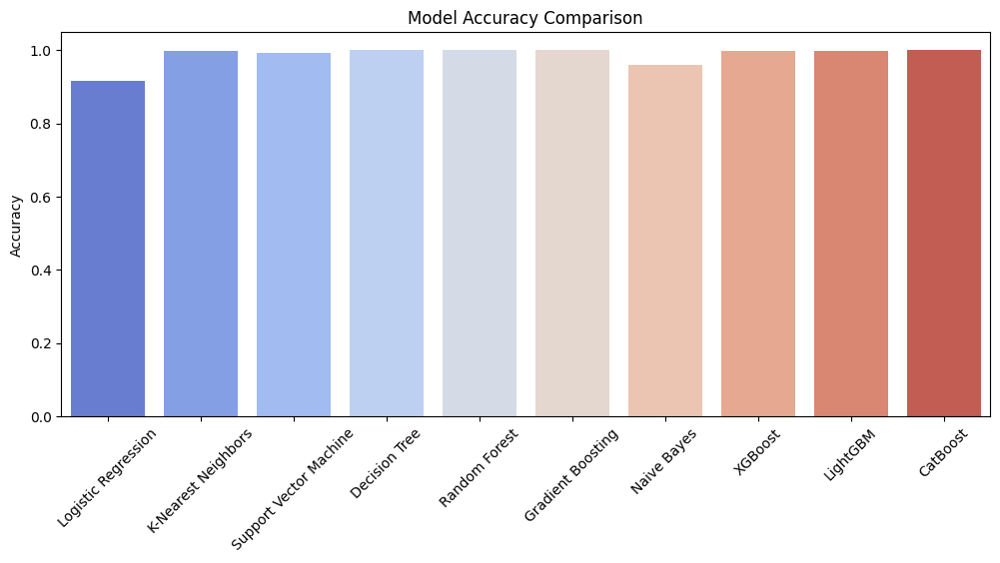

In [42]:
plt.figure(figsize=(12,5))
sns.barplot(x=list(results.keys()), y=list(results.values()), palette="coolwarm")
plt.xticks(rotation=45)
plt.ylabel("Accuracy")
plt.title("Model Accuracy Comparison")
plt.show()


In [43]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, roc_curve, auc, precision_recall_curve

# Function to plot confusion matrix
def plot_confusion_matrix(y_true, y_pred, model_name):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title(f'Confusion Matrix - {model_name}')
    plt.show()


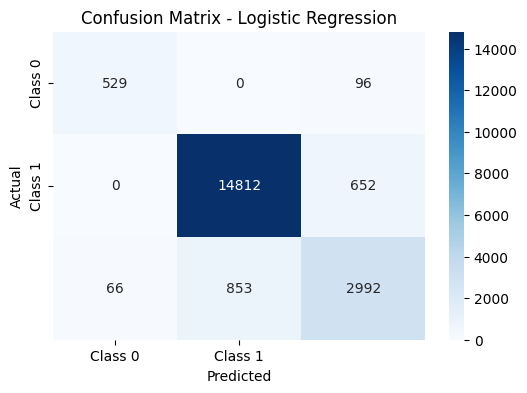

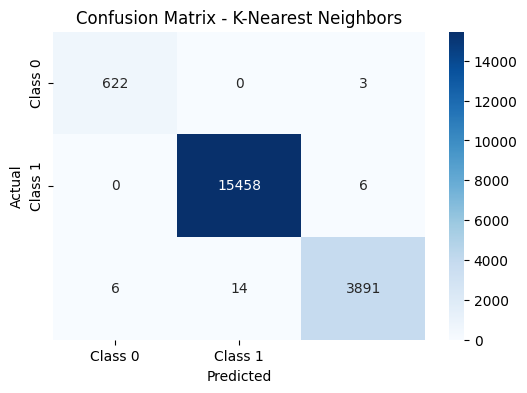

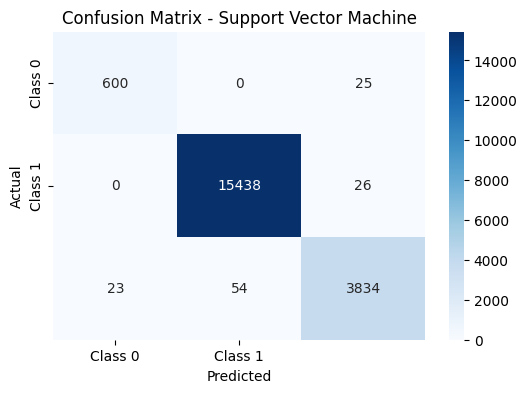

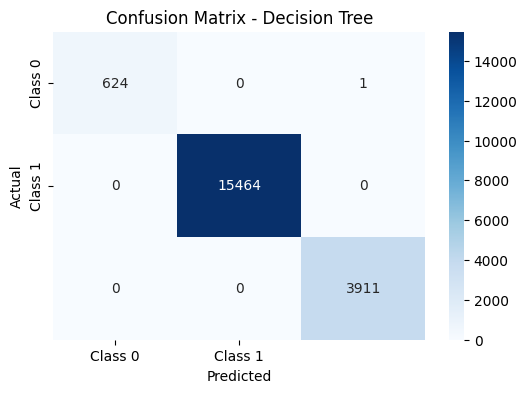

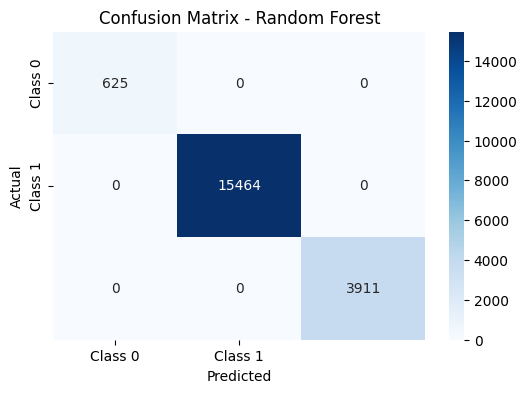

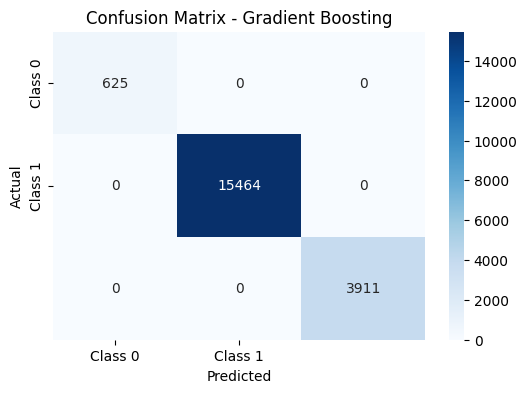

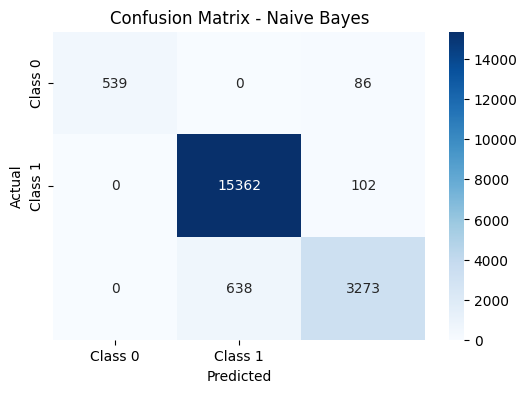

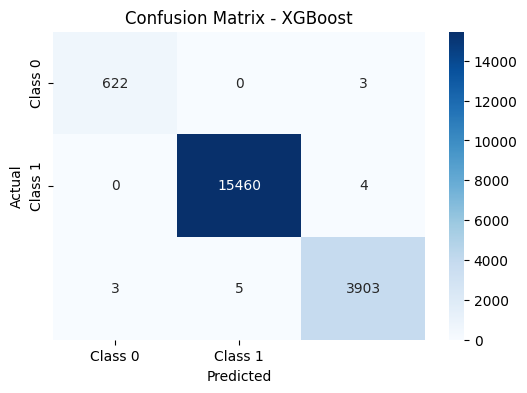

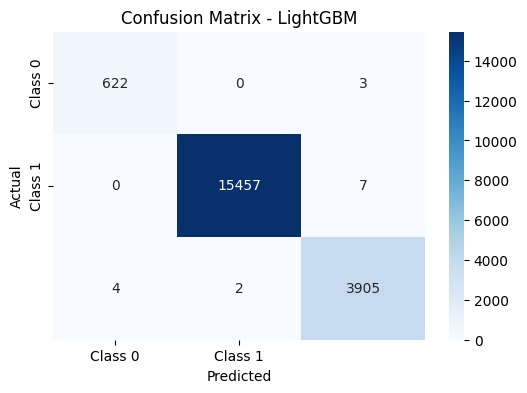

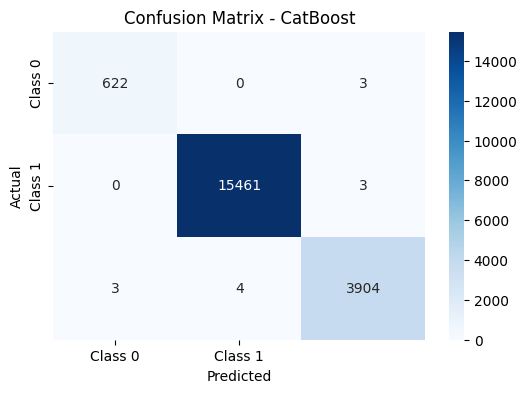

In [44]:
for name, model in models.items():
    y_pred = model.predict(X_test)
    plot_confusion_matrix(y_test, y_pred, name)




---

## 🧑🏻‍💻 About the Author  
**Name:** Arif Miah  

🎓 **Profession:** Machine Learning Engineer & Data Scientist  

---

### 🔭 **Career Objective**  
🚀 My goal is to contribute to groundbreaking advancements in artificial intelligence and data science, empowering companies and individuals with data-driven solutions. I strive to simplify complex challenges, craft innovative projects, and pave the way for a smarter and more connected future.  

🔍 As a **Machine Learning Engineer** and **Data Scientist**, I am passionate about using machine learning, deep learning, computer vision, and advanced analytics to solve real-world problems. My expertise lies in delivering impactful solutions by leveraging cutting-edge technologies.  

---

### 💻 **Skills**  
- 🤖 **Artificial Intelligence & Machine Learning**  
- 👁️‍🗨️ **Computer Vision & Predictive Analytics**  
- 🧠 **Deep Learning & Natural Language Processing (NLP)**  
- 🐍 **Python Programming & Automation**  
- 📊 **Data Visualization & Analysis**  
- 🚀 **End-to-End Model Development & Deployment**  

---

### 🚧 **Featured Projects**  

📊 **Lung Cancer Prediction with Deep Learning**  
Achieved 99% accuracy in a computer vision project using 12,000 medical images across three classes. This project involved data preprocessing, visualization, and model training to detect cancer effectively.  

🌾 **Ghana Crop Disease Detection Challenge**  
Developed a model using annotated images to identify crop diseases with bounding boxes, addressing real-world agricultural challenges and disease mitigation.  

🛡️ **Global Plastic Waste Analysis**  
Utilized GeoPandas, Matplotlib, and machine learning models like RandomForestClassifier and CatBoostClassifier to analyze trends in plastic waste management.  

🎵 **Twitter Emotion Classification**  
Performed exploratory data analysis and built a hybrid machine learning model to classify Twitter sentiments, leveraging text data preprocessing and visualization techniques.  

---

### ⚙️ **Technical Skills**  

- 💻 **Programming Languages:** Python 🐍, SQL 🗃️, R 📈  
- 📊 **Data Visualization Tools:** Matplotlib 📉, Seaborn 🌊, Tableau 📊, Power BI 📊  
- 🧠 **Machine Learning & Deep Learning:** Scikit-learn 🤖, TensorFlow 🔥, PyTorch 🧩  
- 🗂️ **Big Data Technologies:** Hadoop 🏗️, Spark ⚡  
- 🚀 **Model Deployment:** Flask 🌐, FastAPI ⚡, Docker 🐳  

---

### 🌐 **Connect with Me**  

📧 **Email:** arifmiahcse@gmail.com 

🔗 **LinkedIn:** [www.linkedin.com/in/arif-miah-8751bb217](#)  

🐱 **GitHub:** [https://github.com/Arif-miad](#)  

 

